# Procesamiento de Señales de Audio en Musica

In [2]:
import matplotlib.pyplot as plt
import numpy as np
import librosa
import librosa.display
import IPython.display as ipd
from IPython.display  import Audio
from sklearn import preprocessing

# Carga de audios

In [3]:
jazz = "data/jazz/Ella Fitzgerald - How High The Moon (High Quality - Remastered)_djZCe7ou3kY.mp3"
opera = "data/opera/NessunDorma_Opera.mp3"
rap = "data/rap/Big Poppa.mp3"
reggae = "data/reggae/Bob Marley - Get Up Stand Up [HQ Sound]-X2W3aG8uizA.mp3"
rock = "data/rock/Iron Maiden - The Trooper (Official Video)-X4bgXH3sJ2Q.mp3"


jazz_s, sr = librosa.load(jazz)
opera_s, _ = librosa.load(opera)
reggae_s, _ = librosa.load(reggae)
rap_s, _ = librosa.load(rap)
rock_s, _ = librosa.load(rock)

Audio("data/rock/Iron Maiden - The Trooper (Official Video)-X4bgXH3sJ2Q.mp3")
Audio("data/jazz/Ella Fitzgerald - How High The Moon (High Quality - Remastered)_djZCe7ou3kY.mp3")

# Características de dominio temporal

## Waveforms

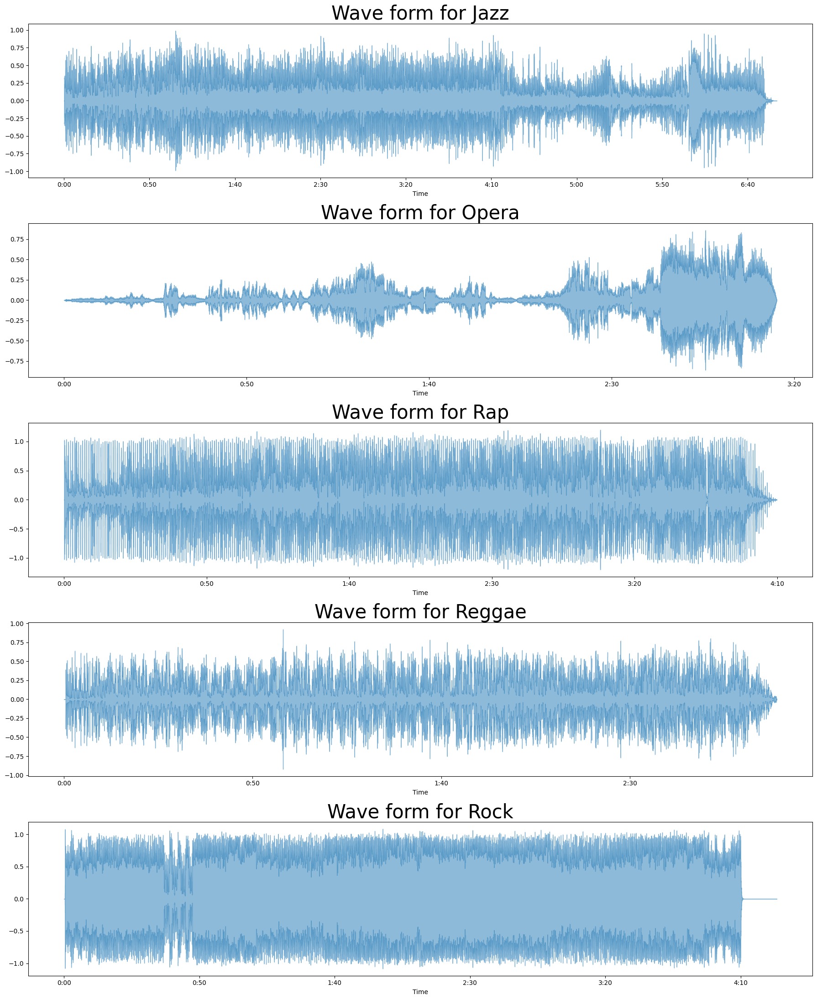

In [4]:
# Función para generar el espectrograma y plotearlo
def plot_waveshow(ax, audio_signal, title, sr):
    librosa.display.waveshow(audio_signal, sr=sr, ax=ax, alpha=0.5)
    ax.set_title(title, fontsize = 30)

# Crear la figura y los subgráficos
fig, axes = plt.subplots(nrows=5, ncols=1, figsize=(18, 22))

plot_waveshow(axes[0], jazz_s, 'Wave form for Jazz', sr)
plot_waveshow(axes[1], opera_s, 'Wave form for Opera', sr)
plot_waveshow(axes[2], rap_s, 'Wave form for Rap', sr)
plot_waveshow(axes[3], reggae_s, 'Wave form for Reggae', sr)
plot_waveshow(axes[4], rock_s, 'Wave form for Rock', sr)

# Ajustar el diseño de la figura
plt.tight_layout()
# Mostrar la figura
plt.show()

## Amplitude Envelope

Video: https://www.youtube.com/watch?v=rlypsap6Wow&list=PL-wATfeyAMNqIee7cH3q1bh4QJFAaeNv0&index=8

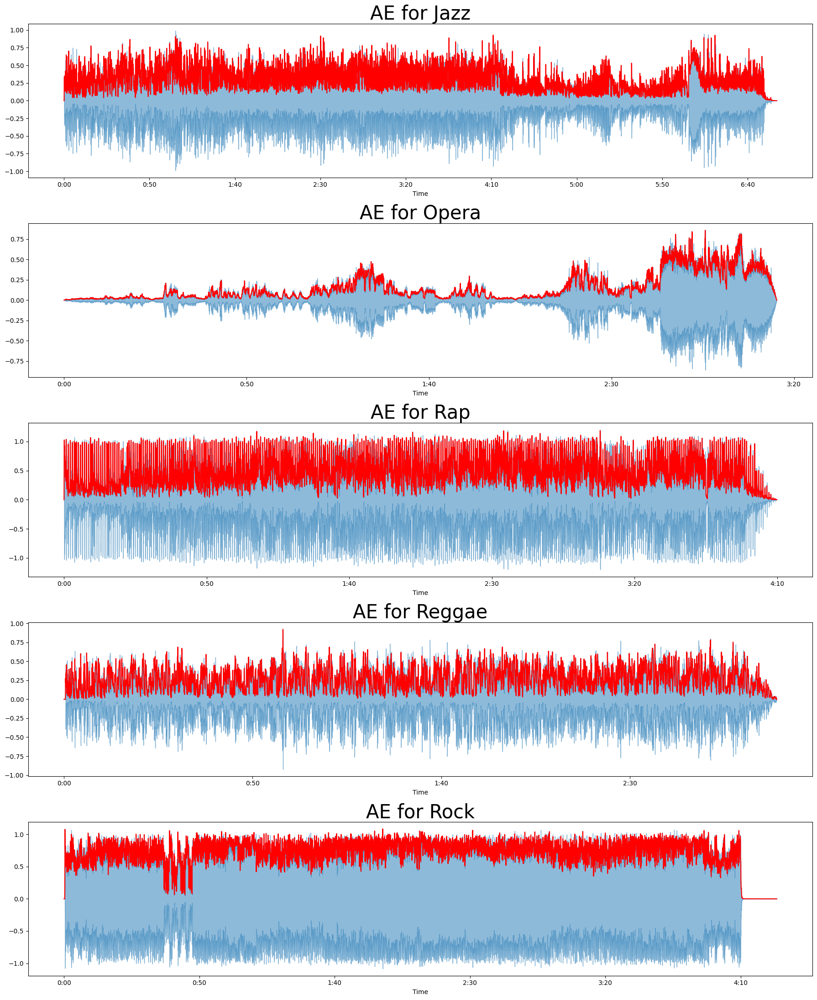

In [5]:
# Duración de un sample
sample_duration = 1/sr

# Extract AE
FRAME_LENGTH = 1024
HOP_LENGTH = 512

def plot_AE(ax, signal, ae, title, name=""):
    frames = range(0, ae.size)
    t = librosa.frames_to_time(frames, hop_length=HOP_LENGTH)

    librosa.display.waveshow(signal, alpha=0.5, ax=ax)
    ax.plot(t, ae, color='r')
    ax.set_title(title)

def amplitude_envelope(signal, frame_size, hop_length):
    amplitude_envelope = []

    # AE para cada frame
    for i in range(0, len(signal), hop_length):
        current_frame_amplitude_envelope = max(signal[i:i+frame_size])
        amplitude_envelope.append(current_frame_amplitude_envelope)

    return np.array(amplitude_envelope)

ae_opera = amplitude_envelope(opera_s, FRAME_LENGTH, HOP_LENGTH)
ae_rock = amplitude_envelope(rock_s, FRAME_LENGTH, HOP_LENGTH)
ae_reggae = amplitude_envelope(reggae_s, FRAME_LENGTH, HOP_LENGTH)
ae_rap = amplitude_envelope(rap_s, FRAME_LENGTH, HOP_LENGTH)
ae_jazz = amplitude_envelope(jazz_s, FRAME_LENGTH, HOP_LENGTH)

# Crear la figura y los subgráficos
fig, axes = plt.subplots(nrows=5, ncols=1, figsize=(18, 22))

plot_AE(axes[0], jazz_s, ae_jazz, 'Waveform for Jazz')
plot_AE(axes[1], opera_s, ae_opera, 'Waveform for Opera')
plot_AE(axes[2], rap_s, ae_rap, 'Waveform for Rap')
plot_AE(axes[3], reggae_s, ae_reggae, 'Waveform for Reggae')
plot_AE(axes[4], rock_s, ae_rock, 'Waveform for Rock')

# También graficar solo el waveform
axes[0].set_title('AE for Jazz', fontsize = 30)
axes[1].set_title('AE for Opera', fontsize = 30)
axes[2].set_title('AE for Rap', fontsize = 30)
axes[3].set_title('AE for Reggae', fontsize = 30)
axes[4].set_title('AE for Rock', fontsize = 30)

# Ajustar el diseño de la figura
plt.tight_layout()
# Mostrar la figura
plt.show()

## Root-Mean Square Energy (RMS)

In [6]:
# Extract RMSE
FRAME_LENGTH = 1024
HOP_LENGTH = 512

rms_opera = librosa.feature.rms(y=opera_s, frame_length=FRAME_LENGTH, hop_length=HOP_LENGTH)[0]
rms_rock = librosa.feature.rms(y=rock_s, frame_length=FRAME_LENGTH, hop_length=HOP_LENGTH)[0]
rms_jazz = librosa.feature.rms(y=jazz_s, frame_length=FRAME_LENGTH, hop_length=HOP_LENGTH)[0]
rms_rap = librosa.feature.rms(y=rap_s, frame_length=FRAME_LENGTH, hop_length=HOP_LENGTH)[0]
rms_reggae = librosa.feature.rms(y=reggae_s, frame_length=FRAME_LENGTH, hop_length=HOP_LENGTH)[0]

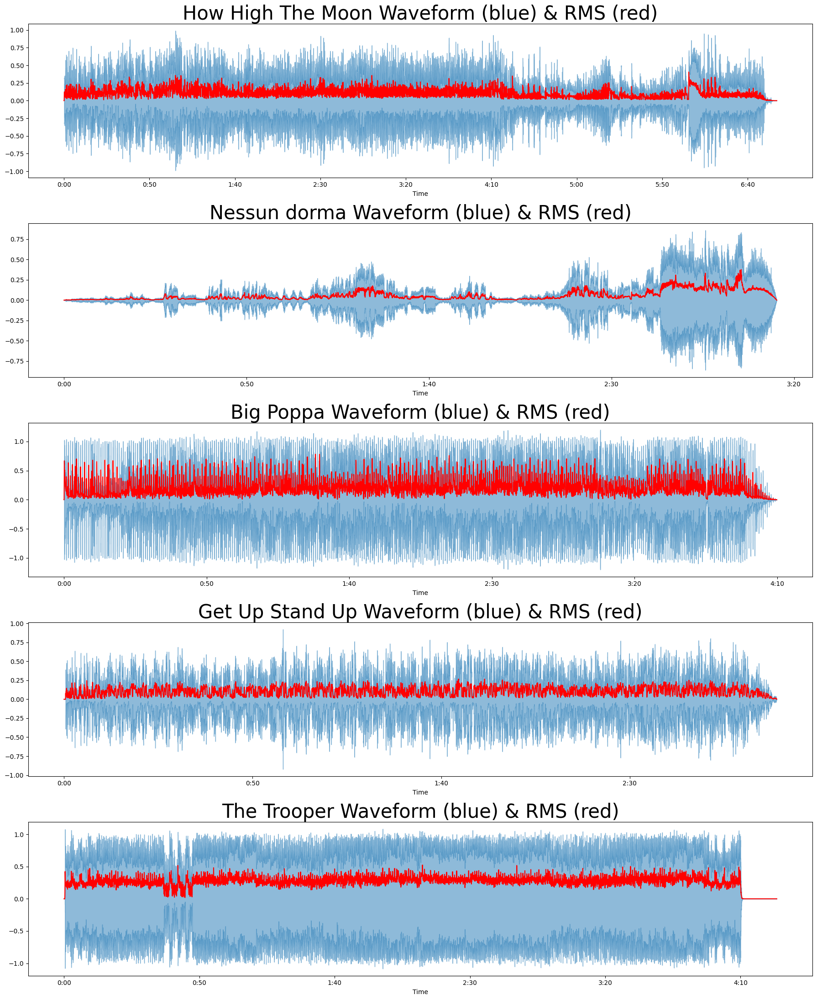

In [7]:
fig, axes = plt.subplots(nrows=5, ncols=1, figsize=(18, 22))

# Plot and set titles for each subplot
frames = range(len(rms_jazz))
t = librosa.frames_to_time(frames, hop_length=HOP_LENGTH)

librosa.display.waveshow(jazz_s, alpha=0.5, ax=axes[0])
axes[0].plot(t, rms_jazz, color='r')
axes[0].set_title('How High The Moon Waveform (blue) & RMS (red)', fontsize = 30)

# Plot and set titles for each subplot
frames = range(len(rms_opera))
t = librosa.frames_to_time(frames, hop_length=HOP_LENGTH)

librosa.display.waveshow(opera_s, alpha=0.5, ax=axes[1])
axes[1].plot(t, rms_opera, color='r')
axes[1].set_title('Nessun dorma Waveform (blue) & RMS (red)', fontsize = 30)

# Plot and set titles for each subplot
frames = range(len(rms_rap))
t = librosa.frames_to_time(frames, hop_length=HOP_LENGTH)

librosa.display.waveshow(rap_s, alpha=0.5, ax=axes[2])
axes[2].plot(t, rms_rap, color='r')
axes[2].set_title('Big Poppa Waveform (blue) & RMS (red)', fontsize = 30)

# Plot and set titles for each subplot
frames = range(len(rms_reggae))
t = librosa.frames_to_time(frames, hop_length=HOP_LENGTH)

librosa.display.waveshow(reggae_s, alpha=0.5, ax=axes[3])
axes[3].plot(t, rms_reggae, color='r')
axes[3].set_title('Get Up Stand Up Waveform (blue) & RMS (red)', fontsize = 30)

# Plot and set titles for each subplot
frames = range(len(rms_rock))
t = librosa.frames_to_time(frames, hop_length=HOP_LENGTH)

librosa.display.waveshow(rock_s, alpha=0.5, ax=axes[4])
axes[4].plot(t, rms_rock, color='r')
axes[4].set_title('The Trooper Waveform (blue) & RMS (red)', fontsize = 30)

plt.tight_layout()
plt.show()



## Tasa de cruces con cero (ZCR)

In [8]:
FRAME_LENGTH = 1024
HOP_LENGTH = 512

zcr_opera = librosa.feature.zero_crossing_rate(y=opera_s, frame_length=FRAME_LENGTH, hop_length=HOP_LENGTH)[0]
zcr_rock = librosa.feature.zero_crossing_rate(y=rock_s, frame_length=FRAME_LENGTH, hop_length=HOP_LENGTH)[0]
zcr_reggae = librosa.feature.zero_crossing_rate(y=reggae_s, frame_length=FRAME_LENGTH, hop_length=HOP_LENGTH)[0]
zcr_jazz = librosa.feature.zero_crossing_rate(y=jazz_s, frame_length=FRAME_LENGTH, hop_length=HOP_LENGTH)[0]
zcr_rap = librosa.feature.zero_crossing_rate(y=rap_s, frame_length=FRAME_LENGTH, hop_length=HOP_LENGTH)[0]

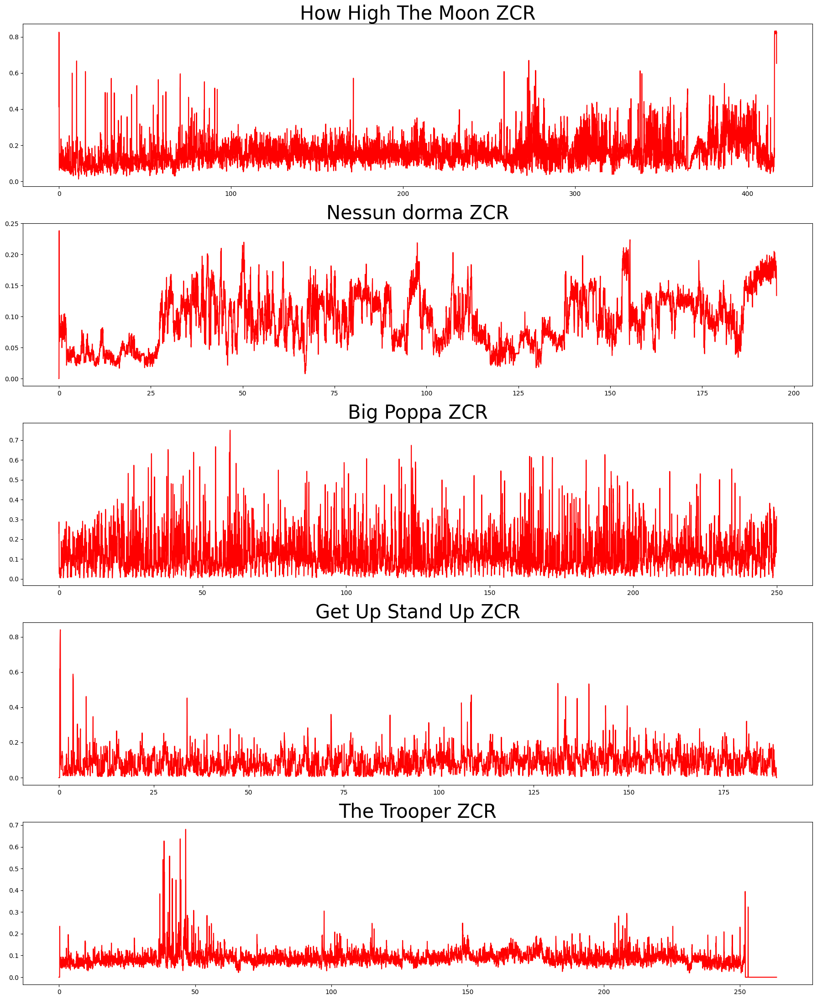

In [9]:
# Crear la figura y los subgráficos
frames = range(len(zcr_rock))
tro = librosa.frames_to_time(frames, hop_length=HOP_LENGTH)
frames = range(len(zcr_rap))
tra = librosa.frames_to_time(frames, hop_length=HOP_LENGTH)
frames = range(len(zcr_reggae))
trg = librosa.frames_to_time(frames, hop_length=HOP_LENGTH)
frames = range(len(zcr_jazz))
tjz = librosa.frames_to_time(frames, hop_length=HOP_LENGTH)
frames = range(len(zcr_opera))
top = librosa.frames_to_time(frames, hop_length=HOP_LENGTH)

fig, axes = plt.subplots(nrows=5, ncols=1, figsize=(18, 22))

axes[0].plot(tjz, zcr_jazz, color='r')
axes[0].set_title('How High The Moon ZCR', fontsize = 30)

axes[1].plot(top, zcr_opera, color='r')
axes[1].set_title('Nessun dorma ZCR', fontsize = 30)

axes[2].plot(tra, zcr_rap, color='r')
axes[2].set_title('Big Poppa ZCR', fontsize = 30)

axes[3].plot(trg, zcr_reggae, color='r')
axes[3].set_title('Get Up Stand Up ZCR', fontsize = 30)

axes[4].plot(tro, zcr_rock , color='r')
axes[4].set_title('The Trooper ZCR', fontsize = 30)

# Ajustar el diseño de la figura
plt.tight_layout()
# Mostrar la figura
plt.show()

# Características de dominio frecuencial

## Spectrum (Transformada de Fourier)

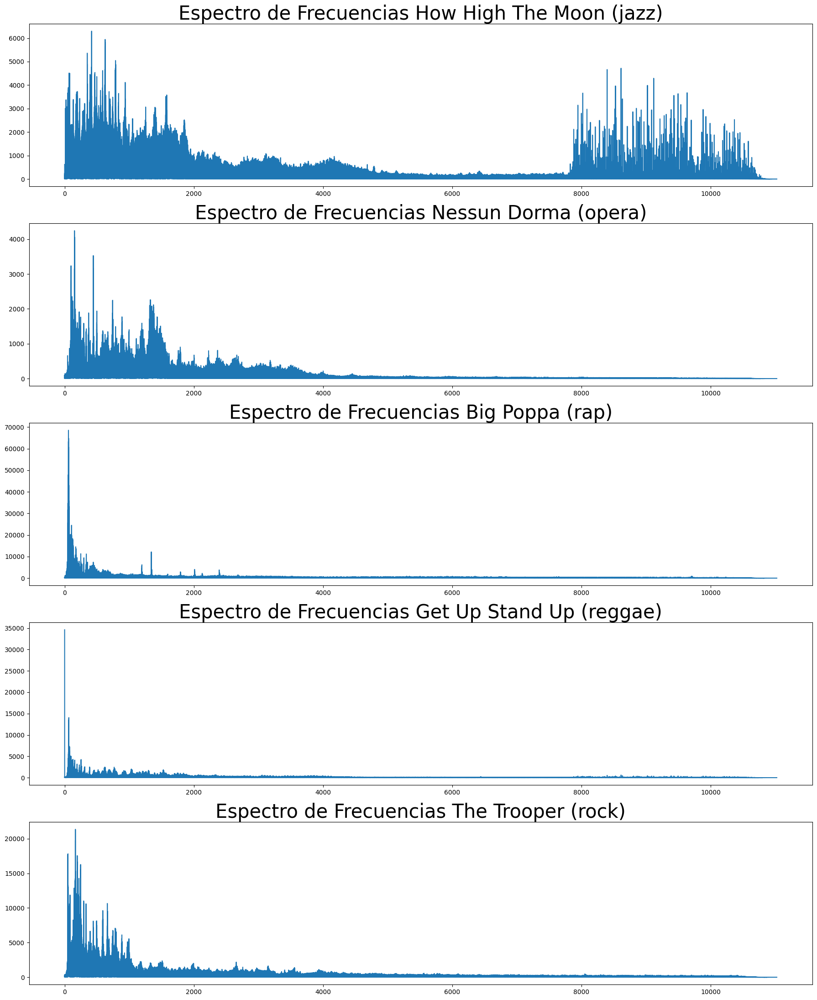

In [10]:
fig, axes = plt.subplots(nrows=5, ncols=1, figsize=(18, 22))

# Calcular la Transformada de Fourier
fft_jazz = np.fft.fft(jazz_s)
mag_jazz = np.abs(fft_jazz)
freq_jazz = np.fft.fftfreq(len(mag_jazz), d=1/sr)

axes[0].plot(freq_jazz[:len(freq_jazz)//2], mag_jazz[:len(freq_jazz)//2])
axes[0].set_title('Espectro de Frecuencias How High The Moon (jazz)', fontsize = 30)
#axes[0].xlabel('Frecuencia (Hz)')
#axes[0].ylabel('Magnitud')

fft_opera = np.fft.fft(opera_s)
mag_opera = np.abs(fft_opera)
freq_opera = np.fft.fftfreq(len(mag_opera), d=1/sr)

axes[1].plot(freq_opera[:len(freq_opera)//2], mag_opera[:len(freq_opera)//2])
axes[1].set_title('Espectro de Frecuencias Nessun Dorma (opera)', fontsize = 30)
#axes[1].xlabel('Frecuencia (Hz)')
#axes[1].ylabel('Magnitud')

fft_rap = np.fft.fft(rap_s)
mag_rap = np.abs(fft_rap)
freq_rap = np.fft.fftfreq(len(mag_rap), d=1/sr)

axes[2].plot(freq_rap[:len(freq_rap)//2], mag_rap[:len(freq_rap)//2])
axes[2].set_title('Espectro de Frecuencias Big Poppa (rap)', fontsize = 30)
#axes[2].xlabel('Frecuencia (Hz)')
#axes[2].ylabel('Magnitud')

fft_reggae = np.fft.fft(reggae_s)
mag_reggae = np.abs(fft_reggae)
freq_reggae = np.fft.fftfreq(len(mag_reggae), d=1/sr)

axes[3].plot(freq_reggae[:len(freq_reggae)//2], mag_reggae[:len(freq_reggae)//2])
axes[3].set_title('Espectro de Frecuencias Get Up Stand Up (reggae)', fontsize = 30)
#axes[3].xlabel('Frecuencia (Hz)')
#axes[3].ylabel('Magnitud')

fft_rock = np.fft.fft(rock_s)
mag_rock = np.abs(fft_rock)
freq_rock = np.fft.fftfreq(len(mag_rock), d=1/sr)

axes[4].plot(freq_rock[:len(freq_rock)//2], mag_rock[:len(freq_rock)//2])
axes[4].set_title('Espectro de Frecuencias The Trooper (rock)', fontsize = 30)
#axes[4].xlabel('Frecuencia (Hz)')
#axes[4].ylabel('Magnitud')

# Ajustar el diseño de la figura
plt.tight_layout()
# Mostrar la figura
plt.show()

# Características de dominio temporal-frecuencial

## Espectograma (Short-Time Fourier Transform)

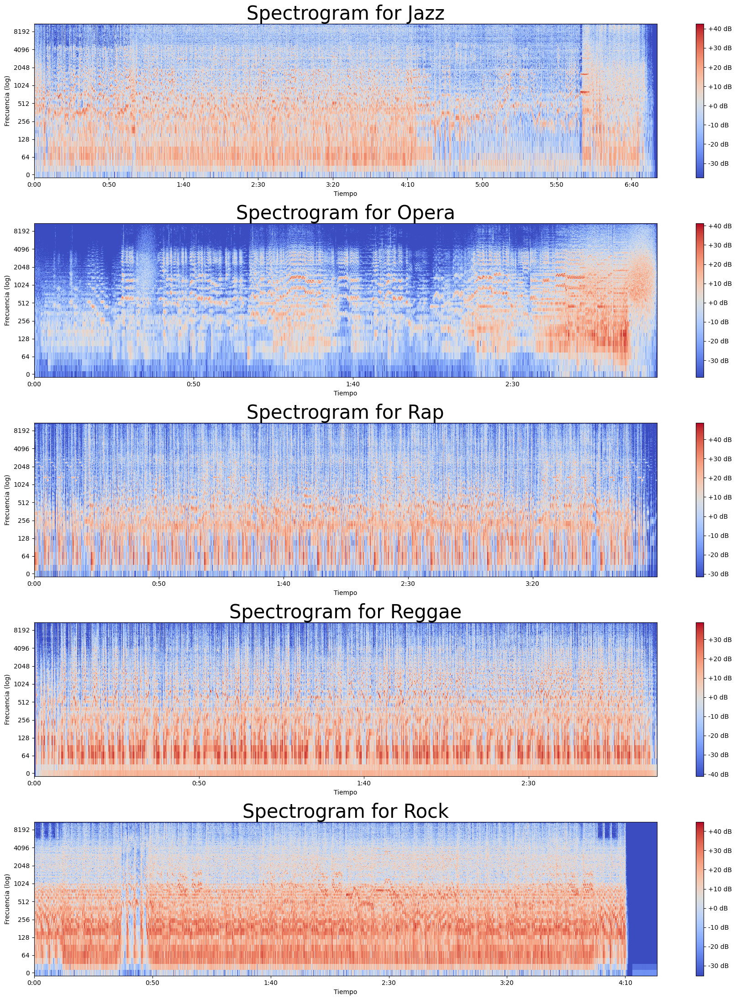

In [12]:
FRAME_LENGTH = 1024
HOP_LENGTH = 512


# Función para generar el espectrograma y plotearlo
def plot_spectrogram(ax, audio_signal, title, sr, hop_length):
    S = librosa.stft(audio_signal, n_fft=FRAME_LENGTH, hop_length=hop_length)
    Y = np.abs(S) ** 2
    Y_log = librosa.power_to_db(Y)
    
    img = librosa.display.specshow(Y_log, sr=sr, hop_length=hop_length, x_axis='time', y_axis='log', ax=ax)
    
    ax.set_title(title, fontsize = 30)
    ax.set_xlabel('Tiempo')
    ax.set_ylabel('Frecuencia (log)')
    plt.colorbar(mappable=img, format='%+2.0f dB', ax=ax)

# Crear la figura y los subgráficos

# Primer fila

fig, axes = plt.subplots(nrows=5, ncols=1, figsize=(18, 22))

plot_spectrogram(axes[0], jazz_s, 'Spectrogram for Jazz', sr, hop_length = HOP_LENGTH)
plot_spectrogram(axes[1], opera_s, 'Spectrogram for Opera', sr,hop_length = HOP_LENGTH)
plot_spectrogram(axes[2], rap_s, 'Spectrogram for Rap', sr,hop_length = HOP_LENGTH)
plot_spectrogram(axes[3], reggae_s, 'Spectrogram for Reggae', sr,hop_length = HOP_LENGTH)
plot_spectrogram(axes[4], rock_s, 'Spectrogram for Rock', sr,hop_length = HOP_LENGTH)

# Ajustar el diseño de la figura
plt.tight_layout()
# Mostrar la figura
plt.show()

# Eliminar el último eje vacío, si es necesario
#axes[1, 2].axis('off')

## Armonicos y Percussión

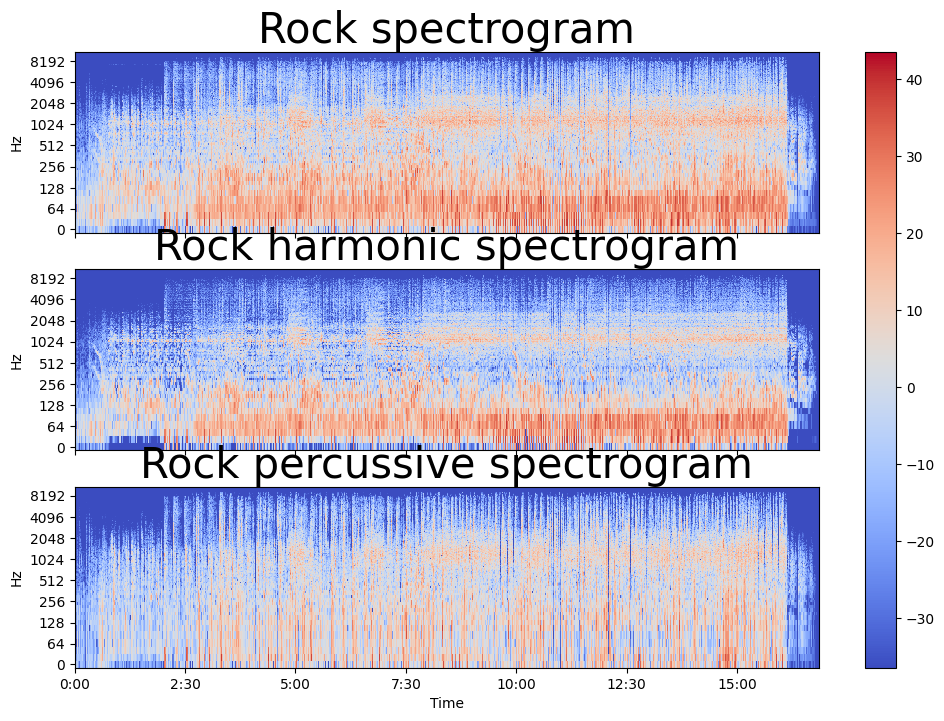

In [14]:
#Carga de datos
samples, sr = librosa.load('data/rock/One.mp3', sr=None)
D=librosa.stft(samples, hop_length=512, n_fft=1024) # calculo stft
H, P = librosa.decompose.hpss(D)# descomposición harmonics y percussive

#representación.
fig, ax = plt.subplots(nrows=3, sharex=True, sharey=True, figsize=(12,8))
img = librosa.display.specshow(librosa.amplitude_to_db(np.abs(D)),
                         y_axis='log', x_axis='time', ax=ax[0])
ax[0].set_title('Rock spectrogram', fontsize=30)
ax[0].label_outer()
librosa.display.specshow(librosa.amplitude_to_db(np.abs(H)),
                         y_axis='log', x_axis='time', ax=ax[1])
ax[1].set_title('Rock harmonic spectrogram', fontsize=30)
ax[1].label_outer()
librosa.display.specshow(librosa.amplitude_to_db(np.abs(P)),
                         y_axis='log', x_axis='time', ax=ax[2])
ax[2].set_title('Rock percussive spectrogram', fontsize=30)
fig.colorbar(img, ax=ax)

## Mel Spectograms

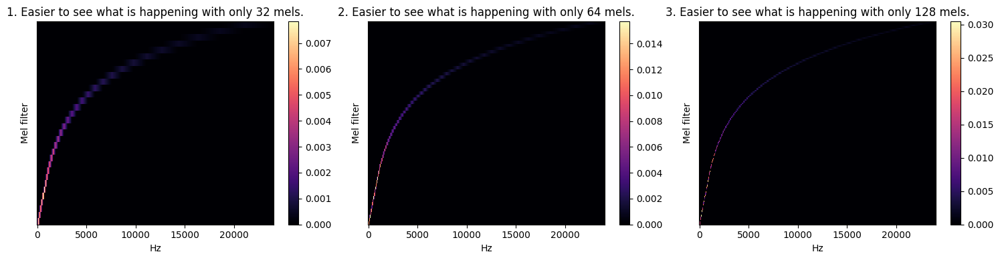

In [15]:
plt.figure(figsize=(15, 4))

plt.subplot(1, 3, 1)
mel_32 = librosa.filters.mel(sr=sr, n_fft=FRAME_LENGTH, n_mels=32)
librosa.display.specshow(mel_32, sr=sr, hop_length=HOP_LENGTH, x_axis='linear')
plt.ylabel('Mel filter')
plt.colorbar()
plt.title('1. Easier to see what is happening with only 32 mels.')

plt.subplot(1, 3, 2)
mel_64 = librosa.filters.mel(sr=sr, n_fft=FRAME_LENGTH, n_mels=64)
librosa.display.specshow(mel_64, sr=sr, hop_length=HOP_LENGTH, x_axis='linear')
plt.ylabel('Mel filter')
plt.colorbar()
plt.title('2. Easier to see what is happening with only 64 mels.')

plt.subplot(1, 3, 3)
mel_128 = librosa.filters.mel(sr=sr, n_fft=FRAME_LENGTH, n_mels=128)
librosa.display.specshow(mel_128, sr=sr, hop_length=HOP_LENGTH, x_axis='linear')
plt.ylabel('Mel filter')
plt.colorbar()
plt.title('3. Easier to see what is happening with only 128 mels.')

plt.tight_layout()

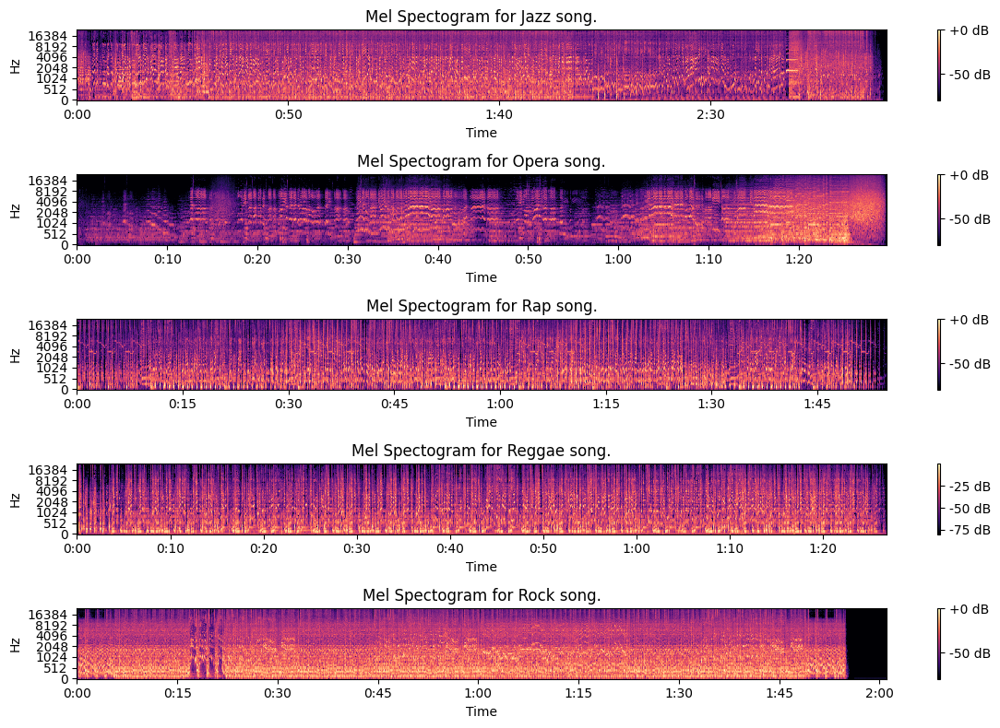

In [16]:
fig, axes = plt.subplots(nrows=5, ncols=1, figsize=(12, 8))

# Primer fila
axes[0].set_title('Mel Spectogram for Jazz song.')
S = librosa.feature.melspectrogram(y=jazz_s, sr=sr, n_fft=FRAME_LENGTH, hop_length=HOP_LENGTH, n_mels=128)
S_DB = librosa.power_to_db(S, ref=np.max)
img = librosa.display.specshow(S_DB, sr=sr, hop_length=HOP_LENGTH, x_axis='time', y_axis='mel', ax=axes[0])
plt.colorbar(mappable=img, format='%+2.0f dB', ax=axes[0])

axes[1].set_title('Mel Spectogram for Opera song.')
S = librosa.feature.melspectrogram(y=opera_s, sr=sr, n_fft=FRAME_LENGTH, hop_length=HOP_LENGTH, n_mels=128)
S_DB = librosa.power_to_db(S, ref=np.max)
img = librosa.display.specshow(S_DB, sr=sr, hop_length=HOP_LENGTH, x_axis='time', y_axis='mel', ax=axes[1])
plt.colorbar(mappable=img, format='%+2.0f dB', ax=axes[1])

axes[2].set_title('Mel Spectogram for Rap song.')
S = librosa.feature.melspectrogram(y=rap_s, sr=sr, n_fft=FRAME_LENGTH, hop_length=HOP_LENGTH, n_mels=128)
S_DB = librosa.power_to_db(S, ref=np.max)
img = librosa.display.specshow(S_DB, sr=sr, hop_length=HOP_LENGTH, x_axis='time', y_axis='mel', ax=axes[2])
plt.colorbar(mappable=img, format='%+2.0f dB', ax=axes[2])

# Segunda fila
axes[3].set_title('Mel Spectogram for Reggae song.')
S = librosa.feature.melspectrogram(y=reggae_s, sr=sr, n_fft=FRAME_LENGTH, hop_length=HOP_LENGTH, n_mels=128)
S_DB = librosa.power_to_db(S, ref=np.max)
img = librosa.display.specshow(S_DB, sr=sr, hop_length=HOP_LENGTH, x_axis='time', y_axis='mel', ax=axes[3])
plt.colorbar(mappable=img, format='%+2.0f dB', ax=axes[3])

axes[4].set_title('Mel Spectogram for Rock song.')
S = librosa.feature.melspectrogram(y=rock_s, sr=sr, n_fft=FRAME_LENGTH, hop_length=HOP_LENGTH, n_mels=128)
S_DB = librosa.power_to_db(S, ref=np.max)
img = librosa.display.specshow(S_DB, sr=sr, hop_length=HOP_LENGTH, x_axis='time', y_axis='mel', ax=axes[4])
plt.colorbar(mappable=img, format='%+2.0f dB', ax=axes[4])

# Eliminar el último eje vacío, si es necesario
#axes[1, 2].axis('off')


# Ajustar el diseño de la figura
plt.tight_layout()

# Mostrar la figura
plt.show()

## Band Energy Ratio

C:\Users\nicol\AppData\Local\Temp\ipykernel_11736\1372887842.py:50: RuntimeWarning: invalid value encountered in scalar divide
  ber_val = low_freq_density / high_freq_density


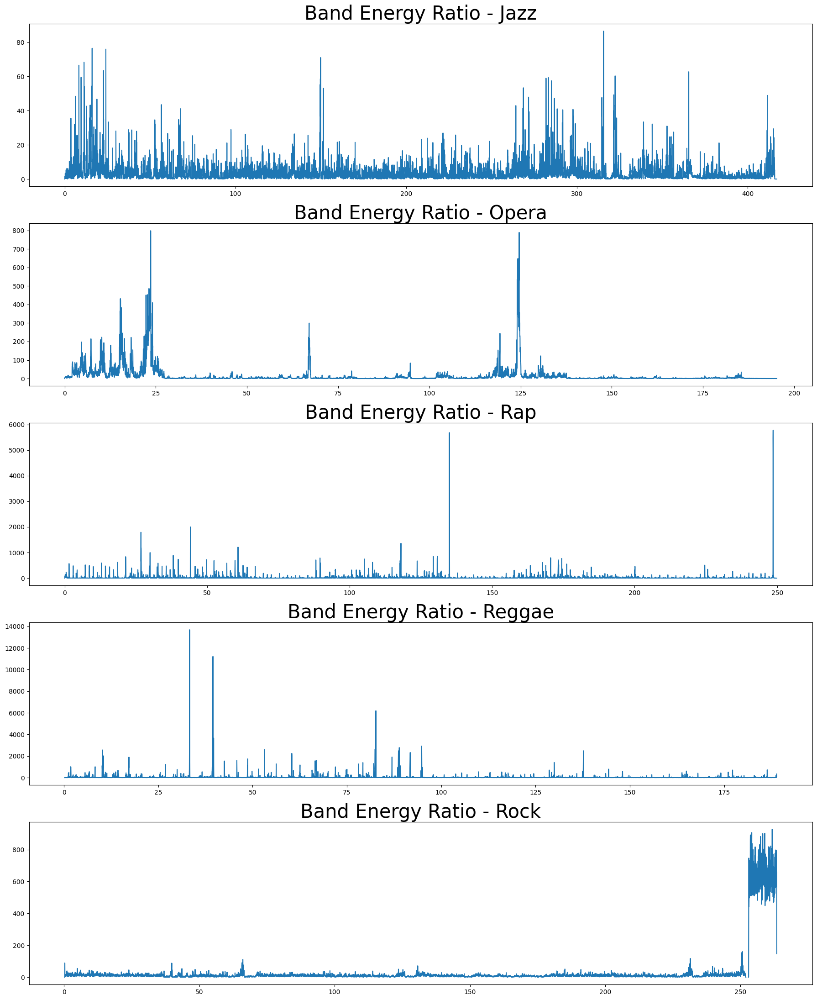

In [18]:
def find_split_freq_bin(spec, split_freq, sample_rate, frame_size=1024, hop_length=512):
    """
    Calculate the bin index corresponding to a given split frequency.

    Args:
        spec (array): The spectrogram.
        split_freq (float): The split frequency in Hz.
        sample_rate (int): The sample rate of the audio.
        frame_size (int, optional): The size of each frame in samples. Default is 1024.
        hop_length (int, optional): The number of samples between consecutive frames. Default is 512.

    Returns:
        int: The bin index corresponding to the split frequency.
    """
    # Calculate the range of frequencies
    range_of_freq = sample_rate / 2
    # Calculate the change in frequency per bin
    change_per_bin = range_of_freq / spec.shape[0]
    # Calculate the bin corresponding to the split frequency
    split_freq_bin = split_freq / change_per_bin
    return int(np.floor(split_freq_bin))

def band_energy_ratio(signal, split_freq, sample_rate, frame_size=1024, hop_length=512):
    """
    Compute the band energy ratio (BER) of a signal.

    Args:
        signal (array): The input signal.
        split_freq (float): The split frequency in Hz.
        sample_rate (int): The sample rate of the audio.
        frame_size (int, optional): The size of each frame in samples. Default is 1024.
        hop_length (int, optional): The number of samples between consecutive frames. Default is 512.

    Returns:
        ndarray: The band energy ratios for each frame of the signal.
    """
    # Compute the spectrogram of the signal
    spec = librosa.stft(signal, n_fft=frame_size, hop_length=hop_length)
    # Find the bin corresponding to the split frequency
    split_freq_bin = find_split_freq_bin(spec, split_freq, sample_rate, frame_size, hop_length)
    # Extract the magnitude and transpose it
    modified_spec = np.abs(spec).T
    res = []
    for sub_arr in modified_spec:
        # Compute the energy in the low-frequency range
        low_freq_density = sum(i ** 2 for i in sub_arr[:split_freq_bin])
        # Compute the energy in the high-frequency range
        high_freq_density = sum(i ** 2 for i in sub_arr[split_freq_bin:])
        # Compute the band energy ratio
        ber_val = low_freq_density / high_freq_density
        res.append(ber_val)
    return np.array(res)


split_freq = 2048
sample_rate = sr
frame_size = FRAME_LENGTH
hop_length = HOP_LENGTH

fig, axes = plt.subplots(nrows=5, ncols=1, figsize=(18, 22))

ber = band_energy_ratio(jazz_s, split_freq, sample_rate, frame_size, hop_length)
frames = range(0, len(ber))
time = librosa.frames_to_time(frames, hop_length=hop_length)
axes[0].plot(time, ber)
axes[0].set_title("Band Energy Ratio - Jazz", fontsize = 30)

ber = band_energy_ratio(opera_s, split_freq, sample_rate, frame_size, hop_length)
frames = range(0, len(ber))
time = librosa.frames_to_time(frames, hop_length=hop_length)
axes[1].plot(time, ber)
axes[1].set_title("Band Energy Ratio - Opera", fontsize = 30)

ber = band_energy_ratio(rap_s, split_freq, sample_rate, frame_size, hop_length)
frames = range(0, len(ber))
time = librosa.frames_to_time(frames, hop_length=hop_length)
axes[2].plot(time, ber)
axes[2].set_title("Band Energy Ratio - Rap", fontsize = 30)

ber = band_energy_ratio(reggae_s, split_freq, sample_rate, frame_size, hop_length)
frames = range(0, len(ber))
time = librosa.frames_to_time(frames, hop_length=hop_length)
axes[3].plot(time, ber)
axes[3].set_title("Band Energy Ratio - Reggae", fontsize = 30)

ber = band_energy_ratio(rock_s, split_freq, sample_rate, frame_size, hop_length)
frames = range(0, len(ber))
time = librosa.frames_to_time(frames, hop_length=hop_length)
axes[4].plot(time, ber)
axes[4].set_title("Band Energy Ratio - Rock", fontsize = 30)

plt.tight_layout()
plt.show()

## Spectral Centroid

In [19]:
FRAME_LENGTH = 1024
HOP_LENGTH = 512

sc_jazz = librosa.feature.spectral_centroid(y=jazz_s, sr=sr, n_fft=FRAME_LENGTH, hop_length=HOP_LENGTH)[0]
sc_opera = librosa.feature.spectral_centroid(y=opera_s, sr=sr, n_fft=FRAME_LENGTH, hop_length=HOP_LENGTH)[0]
sc_rap = librosa.feature.spectral_centroid(y=rap_s, sr=sr, n_fft=FRAME_LENGTH, hop_length=HOP_LENGTH)[0]
sc_reggae = librosa.feature.spectral_centroid(y=reggae_s, sr=sr, n_fft=FRAME_LENGTH, hop_length=HOP_LENGTH)[0]
sc_rock = librosa.feature.spectral_centroid(y=rock_s, sr=sr, n_fft=FRAME_LENGTH, hop_length=HOP_LENGTH)[0]

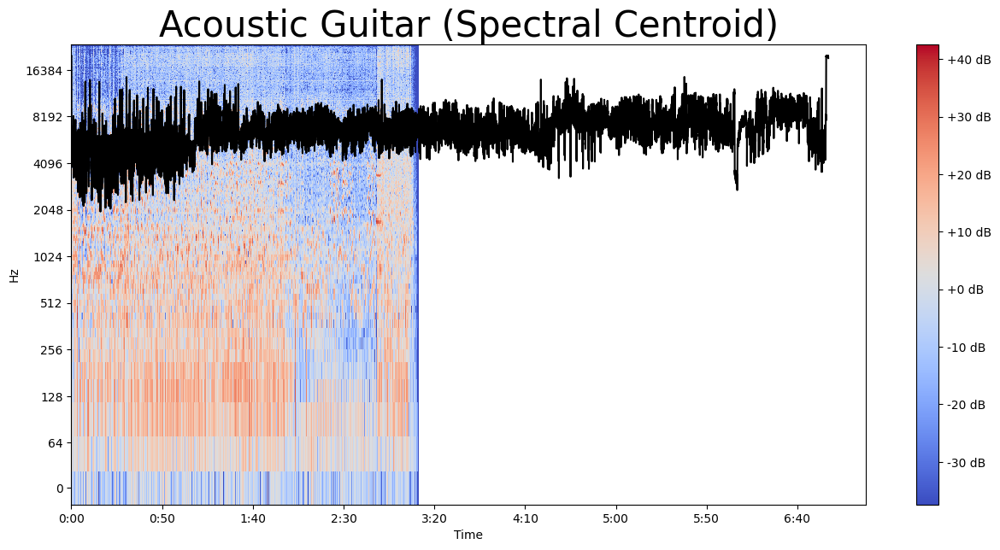

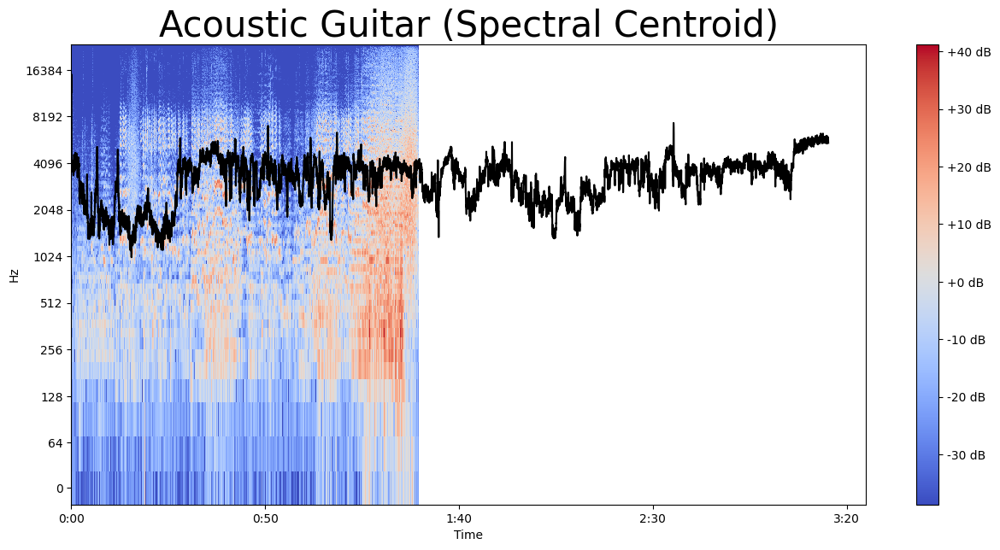

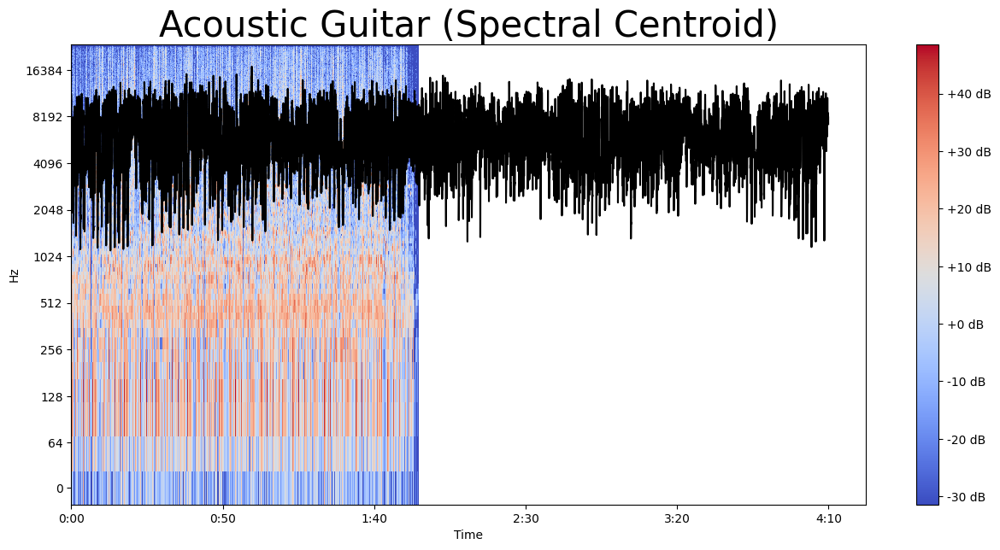

C:\Users\nicol\AppData\Local\Temp\ipykernel_11736\3583950084.py:40: RuntimeWarning: invalid value encountered in scalar divide
  return res/sum(arr)


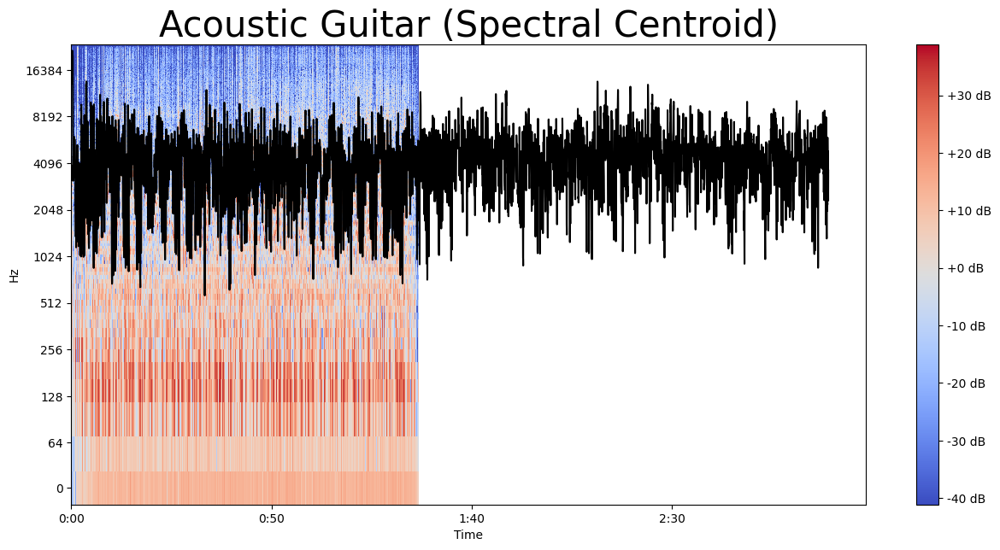

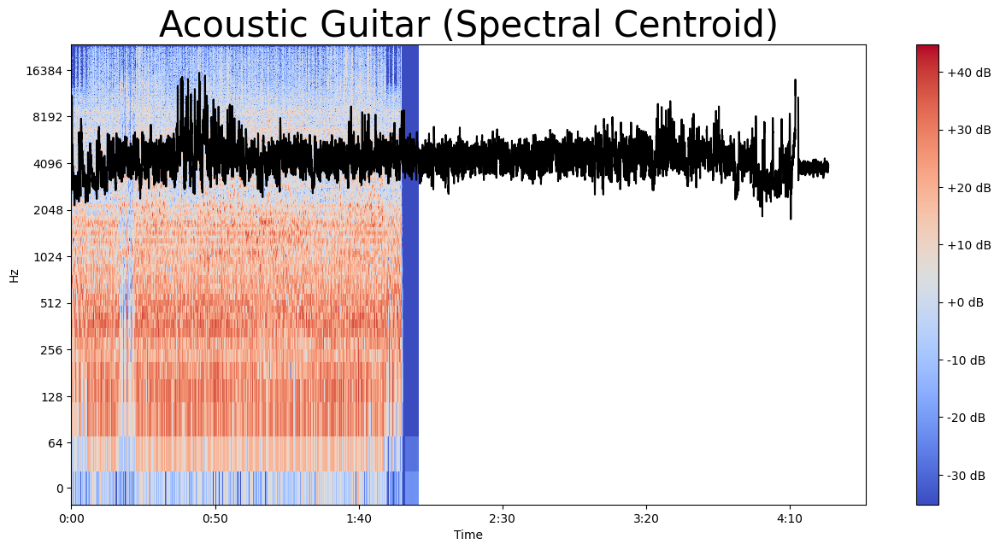

In [20]:
def spectral_centroid(signal, sample_rate, frame_size=1024, hop_length=512):
    """
    Compute the Spectral Centroid of a signal.

    Args:
        signal (array): The input signal.
        sample_rate (int): The sample rate of the audio.
        frame_size (int, optional): The size of each frame in samples. Default is 1024.
        hop_length (int, optional): The number of samples between consecutive frames. Default is 512.

    Returns:
        ndarray: The spectral centroids for each frame of the signal.
    """
    # Compute the spectrogram of the signal
    spec = librosa.stft(signal, n_fft=frame_size, hop_length=hop_length)
    # Extract the magnitude and transpose it
    modified_spec = np.abs(spec).T
    res = []
    for sub_arr in modified_spec:
        # Compute the spectral centroid
        sc_val = sc(sub_arr)
        # Store the value of spectral centroid for current frame
        res.append(sc_val)
    return np.array(res)

def sc(arr):
    """
    Computes the spectral centroid in a signal.

    Args:
        arr (array): Frequency domain array for current frame.

    Returns:
        float: The spectral centroid value for current frame.
    """
    res = 0
    for i in range(0, len(arr)):
        # Compute weighted sum
        res += i*arr[i]
    return res/sum(arr)

def bin_to_freq(spec, bin_val, sample_rate, frame_size=1024, hop_length=512):
    """
    Calculate the frequency corresponding to a given bin value

    Args:
        spec (array): The spectrogram.
        bin_val (): The bin value.
        sample_rate (int): The sample rate of the audio.
        frame_size (int, optional): The size of each frame in samples. Default is 1024.
        hop_length (int, optional): The number of samples between consecutive frames. Default is 512.

    Returns:
        int: The bin index corresponding to the split frequency.
    """
    # Calculate the range of frequencies
    range_of_freq = sample_rate / 2
    # Calculate the change in frequency per bin
    change_per_bin = range_of_freq / spec.shape[0]
    # Calculate the frequency corresponding to the bin
    split_freq = bin_val*change_per_bin
    return split_freq

def plot_spectral_centroid(signal, sample_rate, name, frame_size=1024, hop_length=512, col = "black"):
    """
    Plot the spectral centroid of a signal over time.

    Args:
        signal (ndarray): The input signal.
        sample_rate (int): The sample rate of the audio.
        name (str): The name of the signal for the plot title.
        frame_size (int, optional): The size of each frame in samples. Default is 1024.
        hop_length (int, optional): The number of samples between consecutive frames. Default is 512.
    """
    # Compute the STFT
    spectrogram = librosa.stft(signal, n_fft=frame_size, hop_length=hop_length)  
    # Convert the STFT to dB scale
    spectrogram_db = librosa.amplitude_to_db(np.abs(spectrogram)) 
    # Compute the Spectral Centroid
    sc_arr = spectral_centroid(signal, sample_rate, frame_size, hop_length)
    # Compute corresponding frequencies:
    sc_freq_arr = bin_to_freq(spectrogram_db, sc_arr, sample_rate, frame_size, hop_length)
    # Generate the frame indices
    frames = range(0, len(sc_arr))
    # Convert frames to time
    time = librosa.frames_to_time(frames, hop_length=hop_length)
    # Create a new figure with a specific size
    plt.figure(figsize=(15, 7))
    # Display the Spectrogram
    librosa.display.specshow(spectrogram_db, sr=sample_rate, hop_length=hop_length, x_axis='time', y_axis='log') 
    # Add a colorbar to show the magnitude scale
    plt.colorbar(format='%+2.0f dB')  
    # Plot the Spectral Centroid over time
    plt.plot(time, sc_freq_arr, color=col)
    # Set the title of the plot
    plt.title(name + " (Spectral Centroid)", fontsize=30)
    # Show the plot
    plt.show()
    
plot_spectral_centroid(jazz_s, sr, "Acoustic Guitar")
plot_spectral_centroid(opera_s, sr, "Acoustic Guitar")
plot_spectral_centroid(rap_s, sr, "Acoustic Guitar")
plot_spectral_centroid(reggae_s, sr, "Acoustic Guitar")
plot_spectral_centroid(rock_s, sr, "Acoustic Guitar")

Text(0.5, 1.0, 'Centroide Espectral')

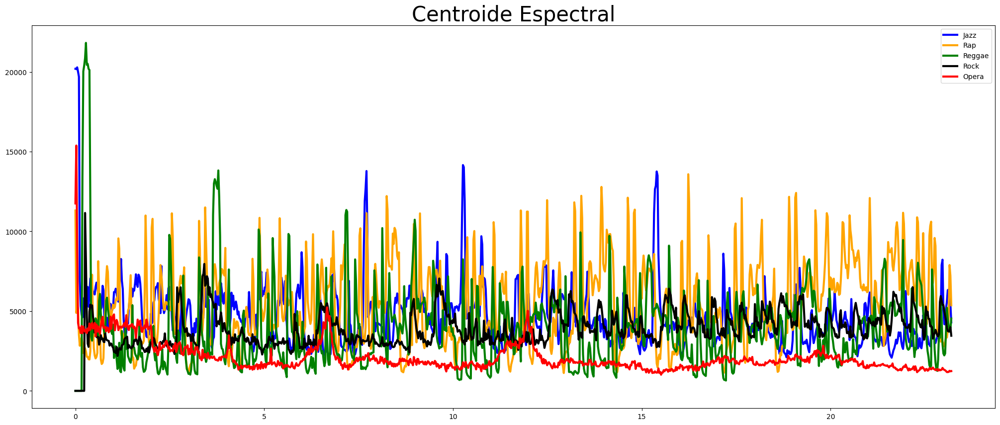

In [21]:
plt.figure(figsize=(25,10))

frames = range(len(sc_jazz[0:1000]))
t = librosa.frames_to_time(frames)
plt.plot(t, sc_jazz[0:1000], color='b', linewidth=3, alpha=1)

frames = range(len(sc_rap[0:1000]))
t = librosa.frames_to_time(frames)
plt.plot(t, sc_rap[0:1000], color='orange', linewidth=3, alpha=1)

frames = range(len(sc_reggae[0:1000]))
t = librosa.frames_to_time(frames)
plt.plot(t, sc_reggae[0:1000], color='g', linewidth=3, alpha=1)

frames = range(len(sc_rock[0:1000]))
t = librosa.frames_to_time(frames)
plt.plot(t, sc_rock[0:1000], color='k', linewidth=3, alpha=1)

frames = range(len(sc_opera[0:1000]))
t = librosa.frames_to_time(frames)
plt.plot(t, sc_opera[0:1000], color='r', linewidth=3, alpha=1)

plt.legend(labels=['Jazz', 'Rap', 'Reggae', 'Rock', 'Opera'])
plt.title('Centroide Espectral', fontsize=30)

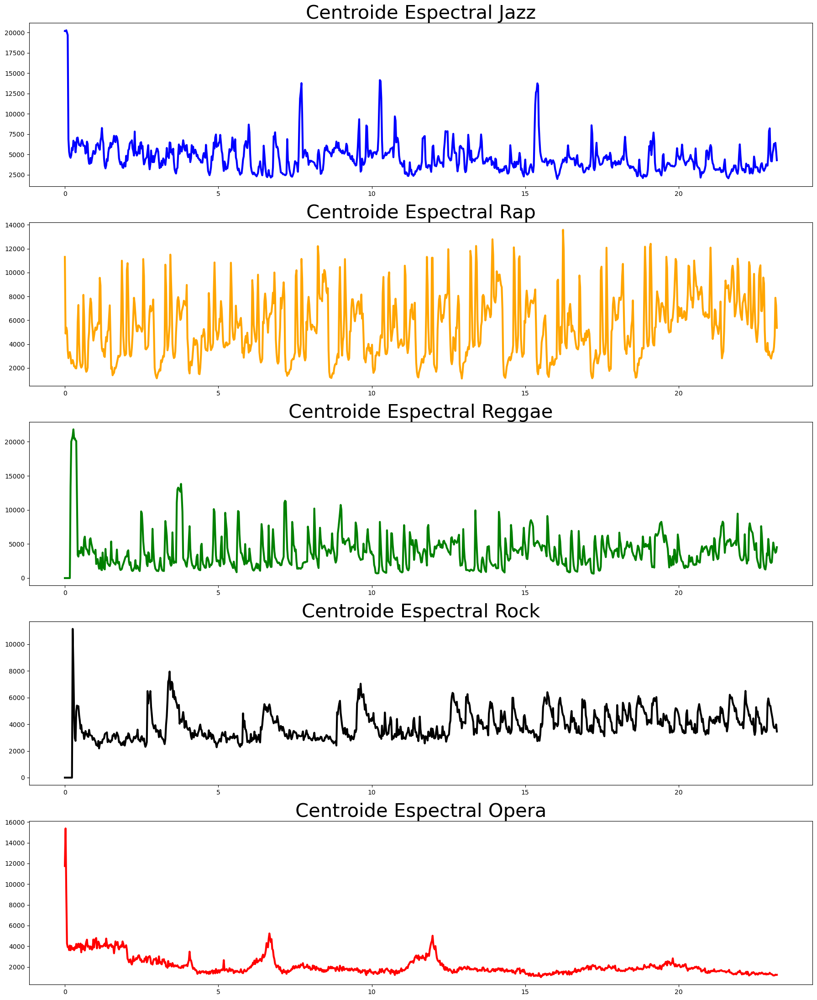

In [ ]:
fig, axes = plt.subplots(nrows=5, ncols=1, figsize=(18, 22))

frames = range(len(sc_jazz[0:1000]))
t = librosa.frames_to_time(frames)
axes[0].plot(t, sc_jazz[0:1000], color='b', linewidth=3, alpha=1)
axes[0].set_title("Centroide Espectral Jazz", fontsize = 30)

frames = range(len(sc_rap[0:1000]))
t = librosa.frames_to_time(frames)
axes[1].plot(t, sc_rap[0:1000], color='orange', linewidth=3, alpha=1)
axes[1].set_title("Centroide Espectral Rap", fontsize = 30)

frames = range(len(sc_reggae[0:1000]))
t = librosa.frames_to_time(frames)
axes[2].plot(t, sc_reggae[0:1000], color='g', linewidth=3, alpha=1)
axes[2].set_title("Centroide Espectral Reggae", fontsize = 30)

frames = range(len(sc_rock[0:1000]))
t = librosa.frames_to_time(frames)
axes[3].plot(t, sc_rock[0:1000], color='k', linewidth=3, alpha=1)
axes[3].set_title("Centroide Espectral Rock", fontsize = 30)

frames = range(len(sc_opera[0:1000]))
t = librosa.frames_to_time(frames)
axes[4].plot(t, sc_opera[0:1000], color='r', linewidth=3, alpha=1)
axes[4].set_title("Centroide Espectral Opera", fontsize = 30)

plt.tight_layout()
plt.show()

## Spectral Bandwidth

In [ ]:
sb_jazz = librosa.feature.spectral_bandwidth(y=jazz_s, sr=sr)[0]
sb_opera = librosa.feature.spectral_bandwidth(y=opera_s, sr=sr)[0]
sb_rap = librosa.feature.spectral_bandwidth(y=rap_s, sr=sr)[0]
sb_reggae = librosa.feature.spectral_bandwidth(y=reggae_s, sr=sr)[0]
sb_rock = librosa.feature.spectral_bandwidth(y=rock_s, sr=sr)[0]

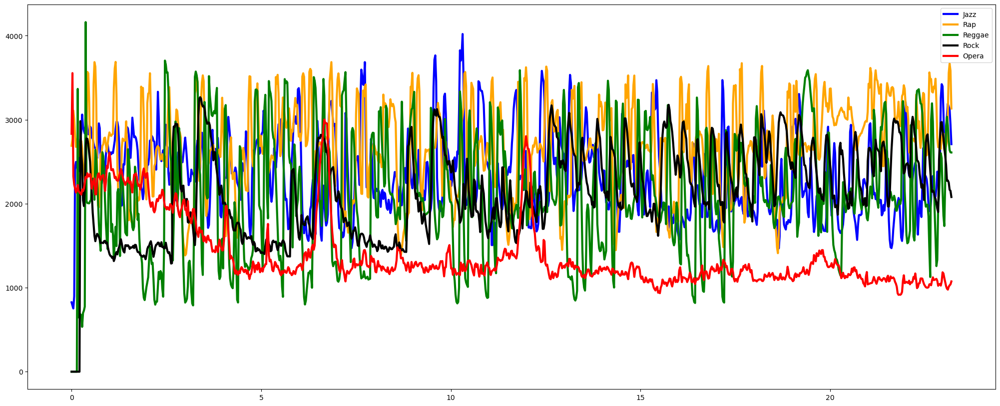

In [ ]:
plt.figure(figsize=(25,10))

frames = range(len(sb_jazz[0:1000]))
t = librosa.frames_to_time(frames)
plt.plot(t, sb_jazz[0:1000], color='b', linewidth=3, alpha=1)

frames = range(len(sb_rap[0:1000]))
t = librosa.frames_to_time(frames)
plt.plot(t, sb_rap[0:1000], color='orange', linewidth=3, alpha=1)

frames = range(len(sb_reggae[0:1000]))
t = librosa.frames_to_time(frames)
plt.plot(t, sb_reggae[0:1000], color='g', linewidth=3, alpha=1)

frames = range(len(sb_rock[0:1000]))
t = librosa.frames_to_time(frames)
plt.plot(t, sb_rock[0:1000], color='k', linewidth=3, alpha=1)

frames = range(len(sb_opera[0:1000]))
t = librosa.frames_to_time(frames)
plt.plot(t, sb_opera[0:1000], color='r', linewidth=3, alpha=1)

plt.legend(labels=['Jazz', 'Rap', 'Reggae', 'Rock', 'Opera'])

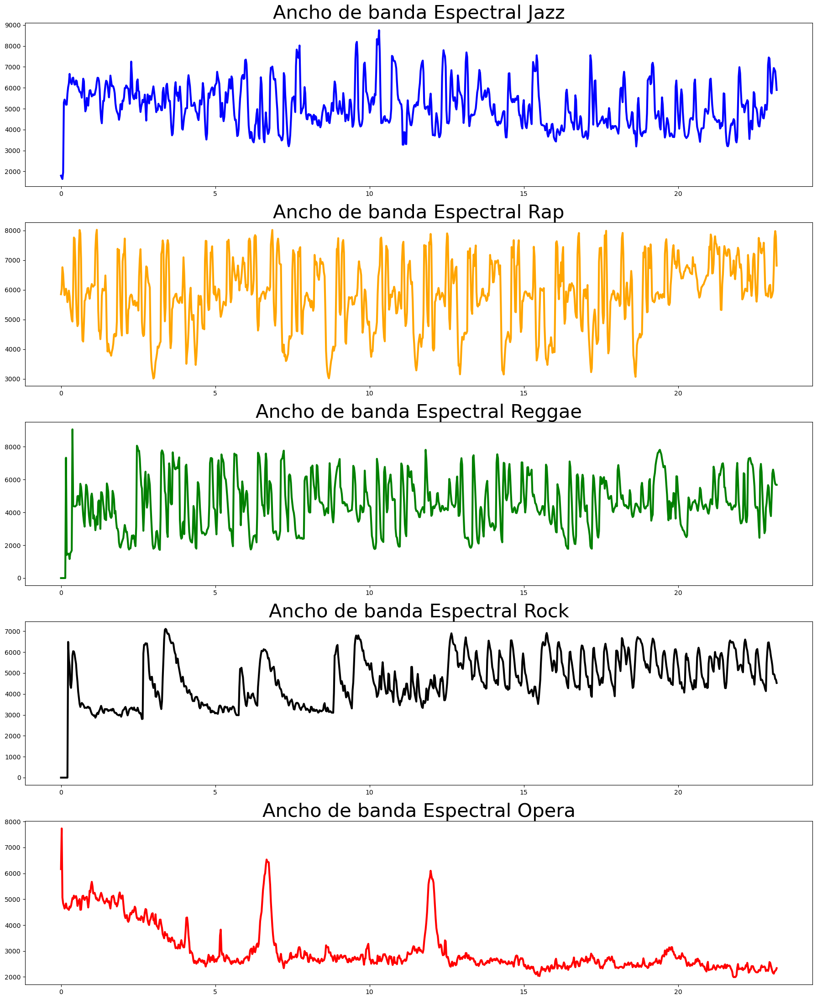

In [ ]:
fig, axes = plt.subplots(nrows=5, ncols=1, figsize=(18, 22))

frames = range(len(sb_jazz[0:1000]))
t = librosa.frames_to_time(frames)
axes[0].plot(t, sb_jazz[0:1000], color='b', linewidth=3, alpha=1)
axes[0].set_title("Ancho de banda Espectral Jazz", fontsize = 30)

frames = range(len(sb_rap[0:1000]))
t = librosa.frames_to_time(frames)
axes[1].plot(t, sb_rap[0:1000], color='orange', linewidth=3, alpha=1)
axes[1].set_title("Ancho de banda Espectral Rap", fontsize = 30)

frames = range(len(sb_reggae[0:1000]))
t = librosa.frames_to_time(frames)
axes[2].plot(t, sb_reggae[0:1000], color='g', linewidth=3, alpha=1)
axes[2].set_title("Ancho de banda Espectral Reggae", fontsize = 30)

frames = range(len(sb_rock[0:1000]))
t = librosa.frames_to_time(frames)
axes[3].plot(t, sb_rock[0:1000], color='k', linewidth=3, alpha=1)
axes[3].set_title("Ancho de banda Espectral Rock", fontsize = 30)

frames = range(len(sb_opera[0:1000]))
t = librosa.frames_to_time(frames)
axes[4].plot(t, sb_opera[0:1000], color='r', linewidth=3, alpha=1)
axes[4].set_title("Ancho de banda Espectral Opera", fontsize = 30)

plt.tight_layout()
plt.show()

## Spectral Rolloff


Caída espectral: Un extractor de características que extrae el punto de caída espectral. Esta es una medida de la cantidad de sesgo a la derecha del espectro de potencia.

El punto de caída espectral es la fracción de contenedores en el espectro de potencia en la que el 85\% de la potencia se encuentra en frecuencias más bajas.

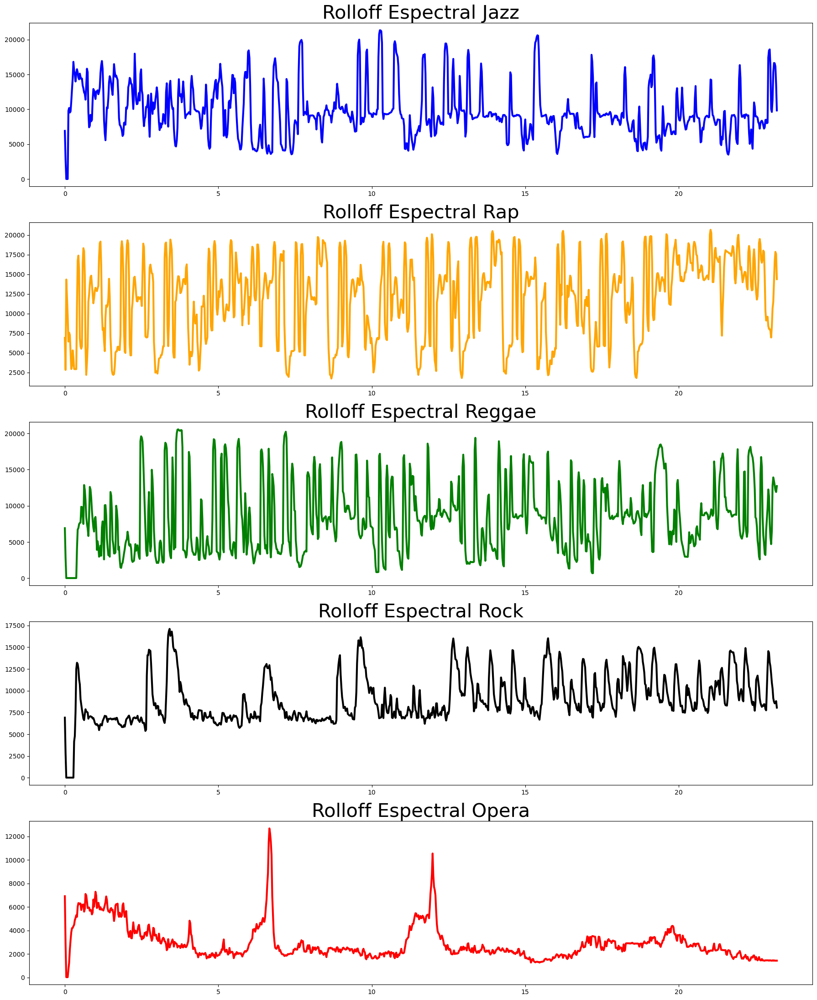

In [ ]:
#CAÍDA ESPECTRAL
# El rolloff espectral es una característica que representa la frecuencia 
#por debajo de la cual se encuentra un cierto porcentaje 
#(generalmente el 85%) de la energía espectral. 
#spr = librosa.feature.spectral_rolloff(samples_reggae+0.01, sr = sr_reggae)

spr_opera = librosa.feature.spectral_rolloff(y=opera_s + 0.01, sr=sr)[0]
spr_jazz = librosa.feature.spectral_rolloff(y=jazz_s + 0.01, sr=sr)[0]
spr_rap = librosa.feature.spectral_rolloff(y=rap_s + 0.01, sr=sr)[0]
spr_rock = librosa.feature.spectral_rolloff(y=rock_s + 0.01, sr=sr)[0]
spr_reggae = librosa.feature.spectral_rolloff(y=reggae_s + 0.01, sr=sr)[0]

fig, axes = plt.subplots(nrows=5, ncols=1, figsize=(18, 22))

frames = range(len(spr_jazz[0:1000]))
t = librosa.frames_to_time(frames)
axes[0].plot(t, spr_jazz[0:1000], color='b', linewidth=3, alpha=1)
axes[0].set_title("Rolloff Espectral Jazz", fontsize = 30)

frames = range(len(spr_rap[0:1000]))
t = librosa.frames_to_time(frames)
axes[1].plot(t, spr_rap[0:1000], color='orange', linewidth=3, alpha=1)
axes[1].set_title("Rolloff Espectral Rap", fontsize = 30)

frames = range(len(spr_reggae[0:1000]))
t = librosa.frames_to_time(frames)
axes[2].plot(t, spr_reggae[0:1000], color='g', linewidth=3, alpha=1)
axes[2].set_title("Rolloff Espectral Reggae", fontsize = 30)

frames = range(len(spr_rock[0:1000]))
t = librosa.frames_to_time(frames)
axes[3].plot(t, spr_rock[0:1000], color='k', linewidth=3, alpha=1)
axes[3].set_title("Rolloff Espectral Rock", fontsize = 30)

frames = range(len(spr_opera[0:1000]))
t = librosa.frames_to_time(frames)
axes[4].plot(t, spr_opera[0:1000], color='r', linewidth=3, alpha=1)
axes[4].set_title("Rolloff Espectral Opera", fontsize = 30)

plt.tight_layout()
plt.show()

## Spectral Flatness

## Frecuencia Cromática

In [22]:
# Compute chroma features for each genre
cromatica_opera = librosa.feature.chroma_stft(y=opera_s, sr=sr, hop_length=HOP_LENGTH)
cromatica_rock = librosa.feature.chroma_stft(y=rock_s, sr=sr, hop_length=HOP_LENGTH)
cromatica_reggae = librosa.feature.chroma_stft(y=reggae_s, sr=sr, hop_length=HOP_LENGTH)
cromatica_jazz = librosa.feature.chroma_stft(y=jazz_s, sr=sr, hop_length=HOP_LENGTH)
cromatica_rap = librosa.feature.chroma_stft(y=rap_s, sr=sr, hop_length=HOP_LENGTH)


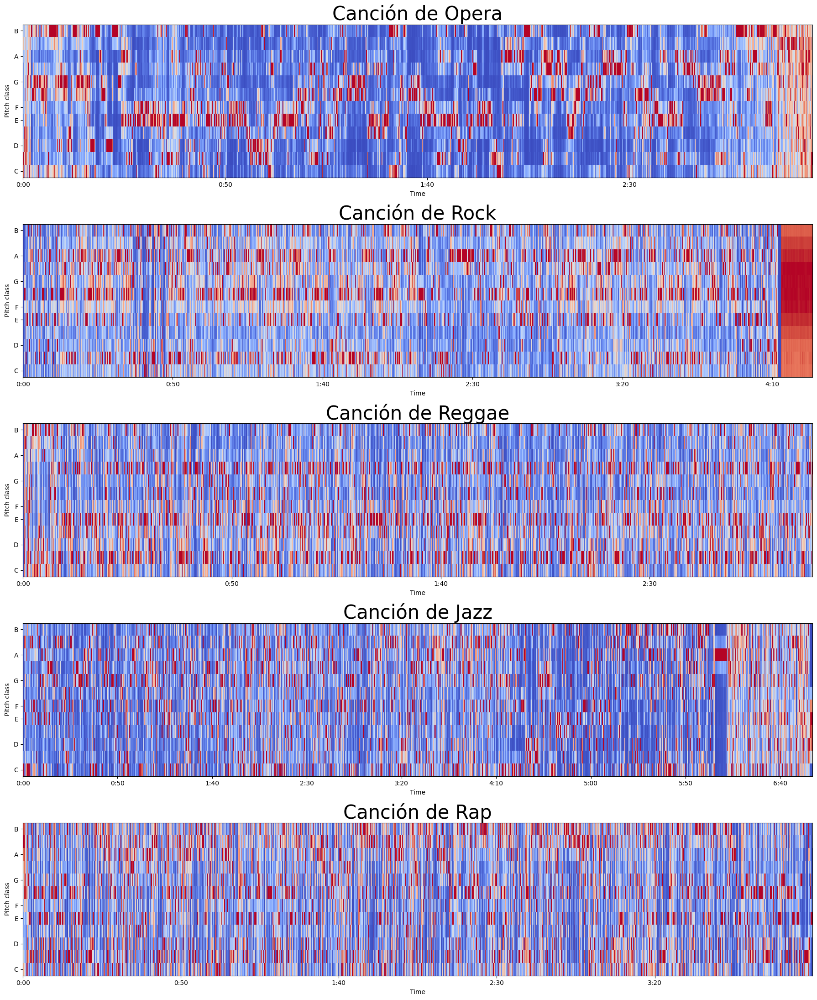

In [23]:
frames = range(len(cromatica_opera))
t = librosa.frames_to_time(frames)

fig, axes = plt.subplots(nrows=5, ncols=1, figsize=(18, 22))

# Opera
librosa.display.specshow(cromatica_opera, y_axis='chroma', ax=axes[0], x_axis='time', cmap='coolwarm')
axes[0].set_title("Canción de Opera", fontsize = 30)

# Rock
frames = range(len(cromatica_rock))
t = librosa.frames_to_time(frames)
librosa.display.specshow(cromatica_rock, y_axis='chroma', x_axis='time', ax=axes[1], cmap='coolwarm')
axes[1].set_title("Canción de Rock", fontsize = 30)

# Reggae
frames = range(len(cromatica_reggae))
t = librosa.frames_to_time(frames)
librosa.display.specshow(cromatica_reggae, y_axis='chroma', x_axis='time', ax=axes[2], cmap='coolwarm')
axes[2].set_title("Canción de Reggae", fontsize = 30)

# Jazz
frames = range(len(cromatica_jazz))
t = librosa.frames_to_time(frames)
librosa.display.specshow(cromatica_jazz, y_axis='chroma', x_axis='time', ax=axes[3], cmap='coolwarm')
axes[3].set_title("Canción de Jazz", fontsize = 30)

# Rap
frames = range(len(cromatica_rap))
t = librosa.frames_to_time(frames)
librosa.display.specshow(cromatica_rap, y_axis='chroma', x_axis='time', ax=axes[4], cmap='coolwarm')
axes[4].set_title("Canción de Rap", fontsize = 30)
plt.tight_layout()
plt.show()

Text(0.5, 1.0, 'Canción Opera')

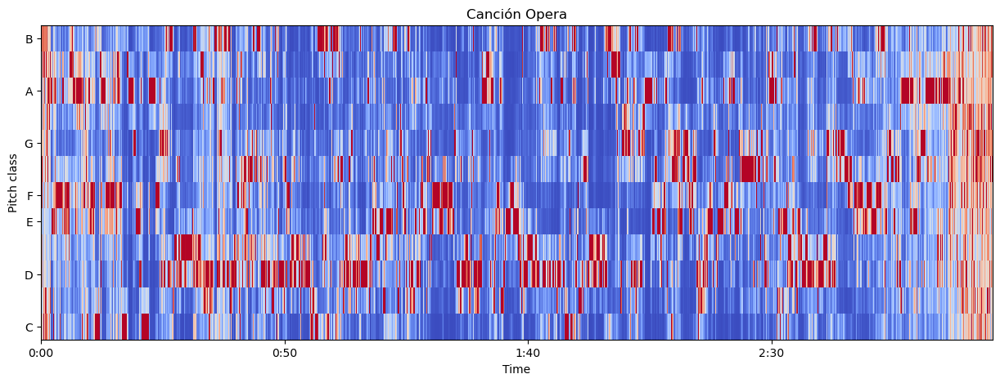

In [ ]:
salto = 512


cromatica = librosa.feature.chroma_stft(y=opera_s, sr=sr, hop_length=salto)
plt.figure(figsize=(15, 5))

#El resultado es una representación cromática de la señal de audio.

librosa.display.specshow(cromatica, x_axis='time', y_axis='chroma', hop_length=salto, cmap='coolwarm')
plt.title("Canción Opera", fontsize = 30)

## Tempograma

Tempograma: se refiere a la velocidad de una pieza musical. Más precisamente, el tempo se refiere a la frecuencia del ritmo musical y viene dado por el recíproco del período de tiempo. El tempo a menudo se define en unidades de latidos por minuto (BPM).

<timed exec>:22: FutureWarning: librosa.beat.tempo
	This function was moved to 'librosa.feature.rhythm.tempo' in librosa version 0.10.0.
	This alias will be removed in librosa version 1.0.
<timed exec>:23: FutureWarning: librosa.beat.tempo
	This function was moved to 'librosa.feature.rhythm.tempo' in librosa version 0.10.0.
	This alias will be removed in librosa version 1.0.
<timed exec>:24: FutureWarning: librosa.beat.tempo
	This function was moved to 'librosa.feature.rhythm.tempo' in librosa version 0.10.0.
	This alias will be removed in librosa version 1.0.
<timed exec>:25: FutureWarning: librosa.beat.tempo
	This function was moved to 'librosa.feature.rhythm.tempo' in librosa version 0.10.0.
	This alias will be removed in librosa version 1.0.
<timed exec>:26: FutureWarning: librosa.beat.tempo
	This function was moved to 'librosa.feature.rhythm.tempo' in librosa version 0.10.0.
	This alias will be removed in librosa version 1.0.


CPU times: total: 16.9 s
Wall time: 28.9 s


Text(0.5, 1.0, 'tempograma reggae')

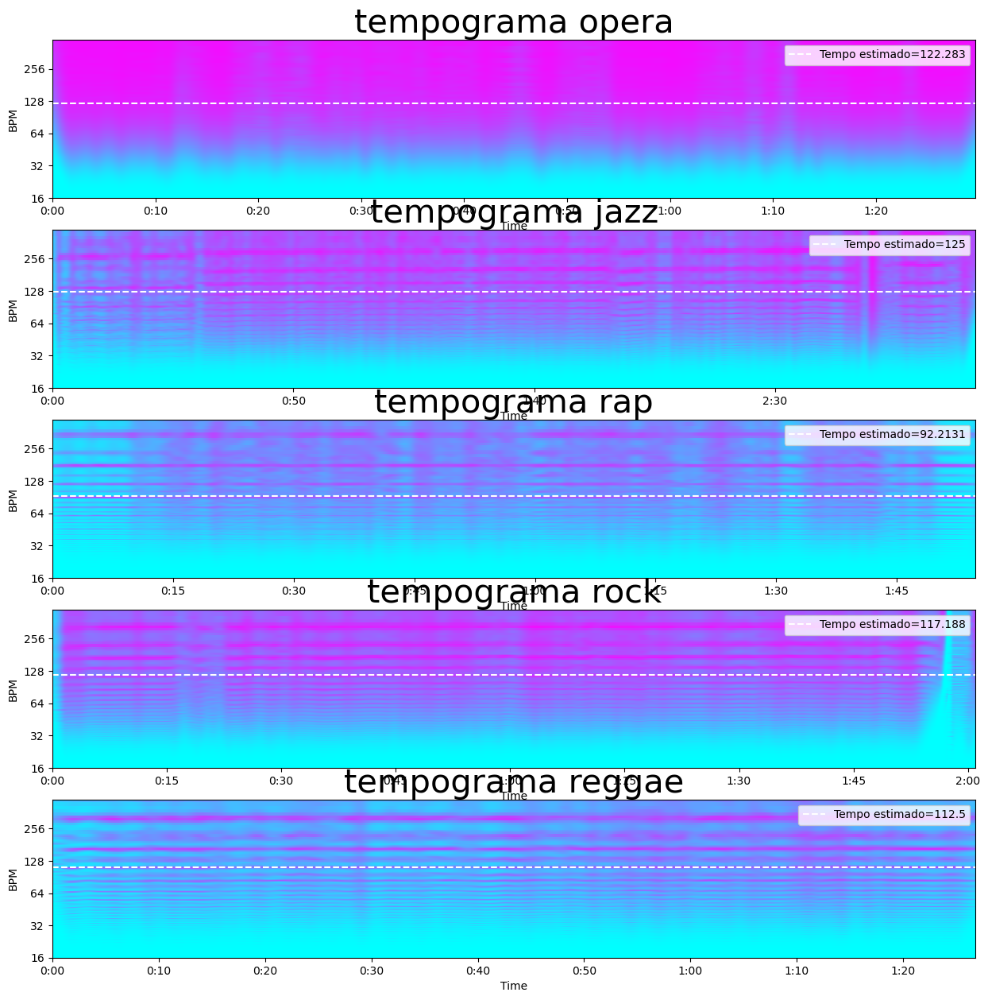

In [ ]:
%%time
#Temmpograma
hop_length = 512
env_opera = librosa.onset.onset_strength(y = opera_s, sr = sr, hop_length = hop_length)
env_jazz = librosa.onset.onset_strength(y = jazz_s, sr = sr, hop_length = hop_length)
env_rap = librosa.onset.onset_strength(y = rap_s, sr = sr, hop_length = hop_length)
env_rock = librosa.onset.onset_strength(y = rock_s, sr = sr, hop_length = hop_length)
env_reggae = librosa.onset.onset_strength(y = reggae_s, sr = sr, hop_length = hop_length)

tempograma_opera = librosa.feature.tempogram(onset_envelope = env_opera, sr = sr, hop_length = hop_length)
tempograma_jazz = librosa.feature.tempogram(onset_envelope = env_jazz, sr = sr, hop_length = hop_length)
tempograma_rap = librosa.feature.tempogram(onset_envelope = env_rap, sr = sr, hop_length = hop_length)
tempograma_rock = librosa.feature.tempogram(onset_envelope = env_rock, sr = sr, hop_length = hop_length)
tempograma_reggae = librosa.feature.tempogram(onset_envelope = env_reggae, sr = sr, hop_length = hop_length)


#el onset envelope resalta los momentos 
#en los que comienzan las notas, golpes u 
#otros eventos importantes en la música


#mostrar los "beats"
tempo_opera = librosa.beat.tempo(onset_envelope = env_opera, sr = sr, hop_length = hop_length)[0]
tempo_jazz = librosa.beat.tempo(onset_envelope = env_jazz, sr = sr, hop_length = hop_length)[0]
tempo_rap = librosa.beat.tempo(onset_envelope = env_rap, sr = sr, hop_length = hop_length)[0]
tempo_rock = librosa.beat.tempo(onset_envelope = env_rock, sr = sr, hop_length = hop_length)[0]
tempo_reggae = librosa.beat.tempo(onset_envelope = env_reggae, sr = sr, hop_length = hop_length)[0]


fig, ax = plt.subplots(nrows=5, figsize=(15, 15))

librosa.display.specshow(tempograma_opera, sr=sr, hop_length=hop_length,x_axis='time', y_axis='tempo', cmap='cool',ax=ax[0])

ax[0].axhline(tempo_opera, color='w', linestyle='--', alpha=1,label='Tempo estimado={:g}'.format(tempo_opera))
ax[0].legend(loc='upper right')
ax[0].set_title('tempograma opera', fontsize=30)

librosa.display.specshow(tempograma_jazz, sr=sr, hop_length=hop_length,x_axis='time', y_axis='tempo', cmap='cool',ax=ax[1])

ax[1].axhline(tempo_jazz, color='w', linestyle='--', alpha=1,label='Tempo estimado={:g}'.format(tempo_jazz))
ax[1].legend(loc='upper right')
ax[1].set_title('tempograma jazz', fontsize=30)

librosa.display.specshow(tempograma_rap, sr=sr, hop_length=hop_length,x_axis='time', y_axis='tempo', cmap='cool',ax=ax[2])

ax[2].axhline(tempo_rap, color='w', linestyle='--', alpha=1,label='Tempo estimado={:g}'.format(tempo_rap))
ax[2].legend(loc='upper right')
ax[2].set_title('tempograma rap', fontsize=30)

librosa.display.specshow(tempograma_rock, sr=sr, hop_length=hop_length,x_axis='time', y_axis='tempo', cmap='cool',ax=ax[3])

ax[3].axhline(tempo_rock, color='w', linestyle='--', alpha=1,label='Tempo estimado={:g}'.format(tempo_rock))
ax[3].legend(loc='upper right')
ax[3].set_title('tempograma rock', fontsize=30)

librosa.display.specshow(tempograma_reggae, sr=sr, hop_length=hop_length,x_axis='time', y_axis='tempo', cmap='cool',ax=ax[4])

ax[4].axhline(tempo_reggae, color='w', linestyle='--', alpha=1,label='Tempo estimado={:g}'.format(tempo_reggae))
ax[4].legend(loc='upper right')
ax[4].set_title('tempograma reggae', fontsize=30)



# Características de dominio cepstral

## Mel-Frequency Cepstral Coefficients 

https://www.youtube.com/watch?v=4_SH2nfbQZ8&list=PL-wATfeyAMNqIee7cH3q1bh4QJFAaeNv0&index=19

Visualización de los MFCCs para la canción de Jazz *How Hight The Moon* de *Ella Fitzgerald*

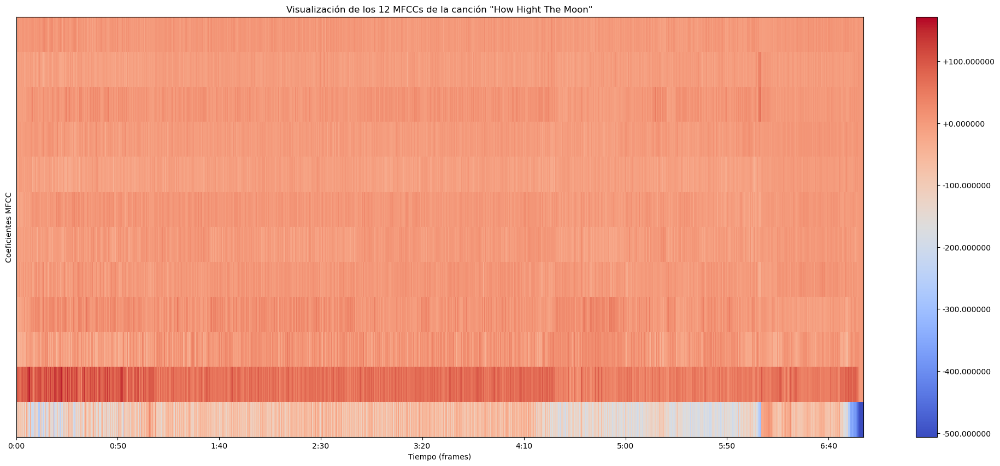

In [ ]:
mfccs = librosa.feature.mfcc(y=jazz_s, n_mfcc=12, sr=sr)

plt.figure(figsize=(25, 10))
librosa.display.specshow(mfccs,
                         x_axis="time",
                         sr=sr)
plt.colorbar(format="%+2f")
plt.title("Visualización de los 12 MFCCs de la canción \"How Hight The Moon\"", fontsize = 30)
plt.xlabel("Tiempo (frames)", fontsize = 10)
plt.ylabel("Coeficientes MFCC", fontsize = 10)
plt.show()

# Implementación

El código correspondiente con la extracción de las características en Python se encuentra en el Notebook con nombre *Features_extraction.ipynb*

El Código correspondiente con la implementación de los algoritmos de Machine Learning implementados en este proyecto se encuentran en el proyecto *Cluster_implementation.ipynb*